<a href="https://colab.research.google.com/github/lincoln-cmd/Portfolio/blob/main/Music_generator/Music_generator_RNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

code from:
 - https://www.tensorflow.org/tutorials/audio/music_generation

reference sites:
 - https://magenta.tensorflow.org/demos/web/

 Setting
 
downdload and import necessary libraries

In [ ]:
!sudo apt install -y fluidsynth

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'sudo apt autoremove' to remove it.
The following additional packages will be installed:
  fluid-soundfont-gm libfluidsynth1 libqt5x11extras5 qsynth
Suggested packages:
  fluid-soundfont-gs timidity jackd
The following NEW packages will be installed:
  fluid-soundfont-gm fluidsynth libfluidsynth1 libqt5x11extras5 qsynth
0 upgraded, 5 newly installed, 0 to remove and 20 not upgraded.
Need to get 120 MB of archives.
After this operation, 150 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 fluid-soundfont-gm all 3.1-5.1 [119 MB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libfluidsynth1 amd64 1.1.9-1 [137 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 fluidsynth amd64 1.1.9-1 [20.7 kB]
Get:4 http://archi

In [ ]:
!pip install --upgrade pyfluidsynth

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install pretty_midi

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 52.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.1/51.1 KB 7.3 MB/s eta 0:00:00
  Created wheel for pretty_midi: filename=pretty_midi-0.2.9-py3-none-any.whl size=5591954 sha256=3b82d63a1394d7b96372354bb1e32f34480c612dfc89e06b359304f15ef57afc
  Stored in directory: /root/.cache/pip/wheels/2a/5a/e3/30eeb9a99350f3f7e21258fcb132743eef1a4f49b3505e76b6
Successfully built pretty_midi


In [ ]:
import collections 
import datetime
import fluidsynth
import glob
import numpy as np
import pathlib
import pandas as pd
import pretty_midi
import seaborn as sns
import tensorflow as tf

from IPython import display
from matplotlib import pyplot as plt
from typing import Dict, List, Optional, Sequence, Tuple

In [ ]:
seed = 42
tf.random.set_seed(seed)
np.random.seed(seed)

# Sampling rate for audio playback
_SAMPLING_RATE = 16000

Download dataset of Maestro

In [ ]:
data_dir = pathlib.Path('data/maestro-v2.0.0')
if not data_dir.exists():
  tf.keras.utils.get_file('maestro-v2.0.0-midi.zip',
                          origin = 'https://storage.googleapis.com/magentadata/datasets/maestro/v2.0.0/maestro-v2.0.0-midi.zip',
                          extract = True,
                          cache_dir = '.',
                          cache_subdir = 'data',)
#data_dir = pathlib.Path('data/maestro-v2.0.0')

59243107/59243107 [==============================] - 1s 0us/step


In [ ]:
#filenames = glob.glob(str(data_dir/'**/*.mid*'))
filenames = glob.glob(str(data_dir/'80879.mid*'))
print('Number of files:', len(filenames))

Number of files: 1


Processing MIDI files

In [ ]:
#sample_file = filenames[1]
sample_file = filenames[0]
print(sample_file)

data/maestro-v2.0.0/80879.mid


In [ ]:
pm = pretty_midi.PrettyMIDI(sample_file)

In [ ]:
def display_audio(pm: pretty_midi.PrettyMIDI, seconds = 248):
  waveform = pm.fluidsynth(fs = _SAMPLING_RATE)
  # Take a sample of the generated waveform to mitigate kernel resets
  waveform_short = waveform[:seconds * _SAMPLING_RATE]
  return display.Audio(waveform_short, rate = _SAMPLING_RATE)

In [ ]:
display_audio(pm)

In [ ]:
print('Numver of instruments:', len(pm.instruments))
instrument = pm.instruments[0]
instrument_name = pretty_midi.program_to_instrument_name(instrument.program)
print('Instrument name:', instrument_name)

Numver of instruments: 1
Instrument name: Acoustic Grand Piano


Extract the memo

In [ ]:
for i, note in enumerate(instrument.notes[:]):
  note_name = pretty_midi.note_number_to_name(note.pitch)
  duration = note.end - note.start
  print(f'{i}: pitch = {note.pitch}, note_name = {note_name},'
  f'duration = {duration:.4f}')

0: pitch = 70, note_name = A#4,duration = 0.8307
1: pitch = 39, note_name = D#2,duration = 0.2865
2: pitch = 55, note_name = G3,duration = 0.1589
3: pitch = 63, note_name = D#4,duration = 0.2005
4: pitch = 67, note_name = G4,duration = 0.1510
5: pitch = 63, note_name = D#4,duration = 0.1719
6: pitch = 58, note_name = A#3,duration = 0.3151
7: pitch = 51, note_name = D#3,duration = 0.2604
8: pitch = 79, note_name = G5,duration = 2.5312
9: pitch = 62, note_name = D4,duration = 0.1042
10: pitch = 56, note_name = G#3,duration = 0.1380
11: pitch = 68, note_name = G#4,duration = 0.0938
12: pitch = 62, note_name = D4,duration = 0.0807
13: pitch = 59, note_name = B3,duration = 0.0885
14: pitch = 77, note_name = F5,duration = 0.5964
15: pitch = 79, note_name = G5,duration = 0.7240
16: pitch = 39, note_name = D#2,duration = 0.2344
17: pitch = 55, note_name = G3,duration = 0.1120
18: pitch = 63, note_name = D#4,duration = 0.1380
19: pitch = 63, note_name = D#4,duration = 0.0781
20: pitch = 67, not

In [ ]:
def midi_to_notes(midi_file: str) -> pd.DataFrame:
  pm = pretty_midi.PrettyMIDI(midi_file)
  instrument = pm.instruments[0]
  notes = collections.defaultdict(list)

  # Sort the notes by start time
  sorted_notes = sorted(instrument.notes, key=lambda note: note.start)
  prev_start = sorted_notes[0].start

  for note in sorted_notes:
    start = note.start
    end = note.end
    notes['pitch'].append(note.pitch)
    notes['start'].append(start)
    notes['end'].append(end)
    notes['step'].append(start - prev_start)
    notes['duration'].append(end - start)
    prev_start = start

  return pd.DataFrame({name: np.array(value) for name, value in notes.items()})

In [ ]:
raw_notes = midi_to_notes(sample_file)
raw_notes.head()

,pitch,start,end,step,duration
0,70,2.000000,2.830729,0.000000,0.830729
1,79,2.770833,5.302083,0.770833,2.531250
2,39,2.786458,3.072917,0.015625,0.286458
3,55,3.500000,3.658854,0.713542,0.158854
4,63,3.502604,3.703125,0.002604,0.200521


In [ ]:
get_note_names = np.vectorize(pretty_midi.note_number_to_name)
sample_note_names = get_note_names(raw_notes['pitch'])
sample_note_names[:10]

array(['A#4', 'G5', 'D#2', 'G3', 'D#4', 'G4', 'A#3', 'D#4', 'D#3', 'F5'],
      dtype='<U3')

In [ ]:
def plot_piano_roll(notes: pd.DataFrame, count: Optional[int] = None):
  if count:
    title = f'First {count} notes'
  else:
    title = f'Whole track'
    count = len(notes['pitch'])
  plt.figure(figsize = (20, 4))
  plot_pitch = np.stack([notes['pitch'], notes['pitch']], axis = 0)
  plot_start_stop = np.stack([notes['start'], notes['end']], axis = 0)
  plt.plot(plot_start_stop[:, :count], plot_pitch[:, :count], color = 'b', marker = '.')
  plt.xlabel('Time [s]')
  plt.ylabel('Pitch')
  _ = plt.title(title)

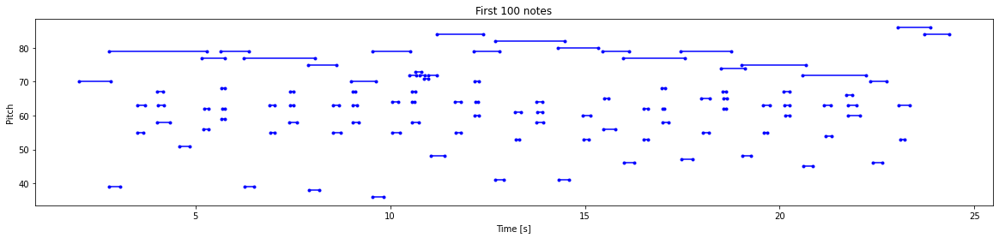

In [ ]:
plot_piano_roll(raw_notes, count = 100)

Floating the memo of all tracks

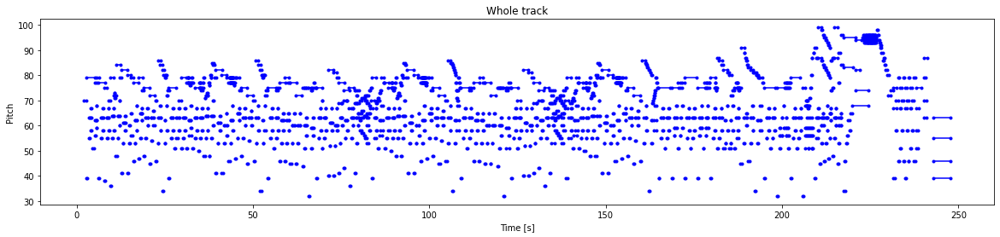

In [ ]:
plot_piano_roll(raw_notes)

In [ ]:
def plot_distributions(notes: pd.DataFrame, drop_percentile = 2.5):
  plt.figure(figsize = [15, 5])
  plt.subplot(1, 3, 1)
  sns.histplot(notes, x = 'pitch', bins = 20)

  plt.subplot(1, 3, 2)
  max_step = np.percentile(notes['step'], 100 - drop_percentile)
  sns.histplot(notes, x = 'step', bins = np.linspace(0, max_step, 21))

  plt.subplot(1, 3, 3)
  max_duration = np.percentile(notes['duration'], 100 - drop_percentile)
  sns.histplot(notes, x = 'duration', bins = np.linspace(0, max_duration, 21))

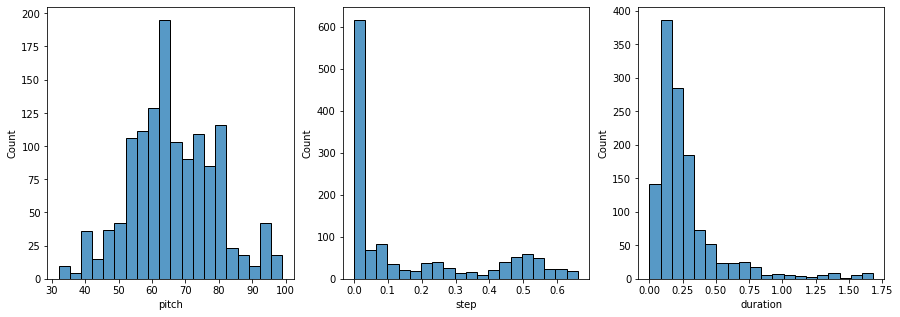

In [ ]:
plot_distributions(raw_notes)

Create MIDI file

In [ ]:
def notes_to_midi(
    notes: pd.DataFrame,
    out_file: str,
    instrument_name: str,
    velocity: int = 100, # note loudness
) -> pretty_midi.PrettyMIDI:
  pm = pretty_midi.PrettyMIDI()
  instrument = pretty_midi.Instrument(program = pretty_midi.instrument_name_to_program(instrument_name))

  prev_start = 0
  for i, note in notes.iterrows():
    start = float(prev_start + note['step'])
    end = float(start + note['duration'])
    note = pretty_midi.Note(velocity = velocity, pitch = int(note['pitch']), start = start, end = end,)
    instrument.notes.append(note)
    prev_start = start

  pm.instruments.append(instrument)
  pm.write(out_file)
  return pm

In [ ]:
example_file = 'example.midi'
example_pm = notes_to_midi(raw_notes, out_file = example_file, instrument_name = instrument_name)

In [ ]:
display_audio(example_pm)

In [ ]:
# download file

#files.download(example_file)

Make train data sets

In [ ]:
num_files = 5
all_notes = []
for f in filenames[:num_files]:
  notes = midi_to_notes(f)
  all_notes.append(notes)

all_notes = pd.concat(all_notes)

In [ ]:
n_notes = len(all_notes)
print('Number of notes parsed:', n_notes)

Number of notes parsed: 1299


In [ ]:
key_order = ['pitch', 'step', 'duration']
train_notes = np.stack([all_notes[key] for key in key_order], axis = 1)

In [ ]:
notes_ds = tf.data.Dataset.from_tensor_slices(train_notes)
notes_ds.element_spec

TensorSpec(shape=(3,), dtype=tf.float64, name=None)

In [ ]:
def create_sequences(dataset: tf.data.Dataset, seq_length: int, vocab_size = 128,) -> tf.data.Dataset:
  '''
  Returns TF Dataset of sequence and label examples.
  '''
  seq_length = seq_length + 1

  # Take 1 extra for the labels
  windows = dataset.window(seq_length, shift = 1, stride = 1, drop_remainder = True)

  # Flat_map flattens the 'dataset of datasets' into a dataset of tensors
  flatten = lambda x: x.batch(seq_length, drop_remainder = True)
  sequences = windows.flat_map(flatten)

  # Normalize note pitch
  def scale_pitch(x):
    x = x / [vocab_size, 1.0, 1.0]
    return x

  # Split the labels
  def split_labels(sequences):
    inputs = sequences[:-1]
    labels_dense = sequences[-1]
    labels = {key:labels_dense[i] for i, key in enumerate(key_order)}

    return scale_pitch(inputs), labels

  return sequences.map(split_labels, num_parallel_calls = tf.data.AUTOTUNE)

In [ ]:
seq_length = 25
vocab_size = 128
seq_ds = create_sequences(notes_ds, seq_length, vocab_size)
seq_ds.element_spec

(TensorSpec(shape=(25, 3), dtype=tf.float64, name=None),
 {'pitch': TensorSpec(shape=(), dtype=tf.float64, name=None),
  'step': TensorSpec(shape=(), dtype=tf.float64, name=None),
  'duration': TensorSpec(shape=(), dtype=tf.float64, name=None)})

In [ ]:
for seq, target in seq_ds.take(1):
  print('sequence shape:', seq.shape)
  print('sequence elements (first 10):', seq[0: 10])
  print()
  print('target:', target)

sequence shape: (25, 3)
sequence elements (first 10): tf.Tensor(
[[0.546875   0.         0.83072917]
 [0.6171875  0.77083333 2.53125   ]
 [0.3046875  0.015625   0.28645833]
 [0.4296875  0.71354167 0.15885417]
 [0.4921875  0.00260417 0.20052083]
 [0.5234375  0.51302083 0.15104167]
 [0.453125   0.00520833 0.31510417]
 [0.4921875  0.00520833 0.171875  ]
 [0.3984375  0.55729167 0.26041667]
 [0.6015625  0.5859375  0.59635417]], shape=(10, 3), dtype=float64)

target: {'pitch': <tf.Tensor: shape=(), dtype=float64, numpy=63.0>, 'step': <tf.Tensor: shape=(), dtype=float64, numpy=0.6119791666666661>, 'duration': <tf.Tensor: shape=(), dtype=float64, numpy=0.15364583333333393>}


In [ ]:
batch_size = 64
buffer_size = n_notes - seq_length # the number of items in the dataset
train_ds = (seq_ds.shuffle(buffer_size).batch(batch_size, drop_remainder = True).cache().prefetch(tf.data.experimental.AUTOTUNE))

In [ ]:
train_ds.element_spec

(TensorSpec(shape=(64, 25, 3), dtype=tf.float64, name=None),
 {'pitch': TensorSpec(shape=(64,), dtype=tf.float64, name=None),
  'step': TensorSpec(shape=(64,), dtype=tf.float64, name=None),
  'duration': TensorSpec(shape=(64,), dtype=tf.float64, name=None)})

Create Model and Learning

In [ ]:
def mse_with_positive_pressure(y_true: tf.Tensor, y_pred: tf.Tensor):
  mse = (y_true - y_pred) ** 2
  positive_pressure = 10 * tf.maximum(-y_pred, 0.0)
  return tf.reduce_mean(mse + positive_pressure)

In [ ]:
input_shape = (seq_length, 3)
learning_rate = 0.005

inputs = tf.keras.Input(input_shape)
x = tf.keras.layers.LSTM(128)(inputs)

outputs = {
    'pitch': tf.keras.layers.Dense(128, name = 'pitch')(x),
    'step': tf.keras.layers.Dense(1, name = 'step')(x),
    'duration': tf.keras.layers.Dense(1, name = 'duration')(x),
}

model = tf.keras.Model(inputs, outputs)

loss = {'pitch': tf.keras.losses.SparseCategoricalCrossentropy(from_logits = True),
        'step': mse_with_positive_pressure,
        'duration': mse_with_positive_pressure,}

optimizer = tf.keras.optimizers.Adam(learning_rate = learning_rate)

model.compile(loss = loss, optimizer = optimizer)

model.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 25, 3)]      0           []                               
                                                                                                  
 lstm_3 (LSTM)                  (None, 128)          67584       ['input_4[0][0]']                
                                                                                                  
 duration (Dense)               (None, 1)            129         ['lstm_3[0][0]']                 
                                                                                                  
 pitch (Dense)                  (None, 128)          16512       ['lstm_3[0][0]']                 
                                                                                            

In [ ]:
losses = model.evaluate(train_ds, return_dict = True)
losses

19/19 [==============================] - 3s 34ms/step - loss: 5.7090 - duration_loss: 0.7736 - pitch_loss: 4.8447 - step_loss: 0.0908


{'loss': 5.708994388580322,
 'duration_loss': 0.7735676765441895,
 'pitch_loss': 4.844674587249756,
 'step_loss': 0.09075295925140381}

In [ ]:
model.compile(loss = loss, loss_weights = {'pitch': 0.05, 'step': 1.0, 'duration': 1.0,}, optimizer = optimizer,)

In [ ]:
model.evaluate(train_ds, return_dict = True)

19/19 [==============================] - 2s 22ms/step - loss: 1.1066 - duration_loss: 0.7736 - pitch_loss: 4.8447 - step_loss: 0.0908


{'loss': 1.106554388999939,
 'duration_loss': 0.7735676765441895,
 'pitch_loss': 4.844674587249756,
 'step_loss': 0.09075295925140381}

In [ ]:
callbacks = [tf.keras.callbacks.ModelCheckpoint(filepath = './training_checkpoints/ckpt_{epoch}',
                                             save_weights_only = True),
            tf.keras.callbacks.EarlyStopping(monitor = 'loss',
                                             patience = 5,
                                             verbose = 1,
                                             restore_best_weights = True),]

In [ ]:
%%time
epochs = 50

history =model.fit(train_ds, epochs = epochs, callbacks = callbacks,)

Epoch 1/50
19/19 [==============================] - 3s 42ms/step - loss: 0.5901 - duration_loss: 0.2947 - pitch_loss: 4.6968 - step_loss: 0.0606
Epoch 2/50
19/19 [==============================] - 1s 40ms/step - loss: 0.5015 - duration_loss: 0.2272 - pitch_loss: 4.3691 - step_loss: 0.0558
Epoch 3/50
19/19 [==============================] - 1s 43ms/step - loss: 0.4718 - duration_loss: 0.2188 - pitch_loss: 3.9534 - step_loss: 0.0553
Epoch 4/50
19/19 [==============================] - 1s 68ms/step - loss: 0.4527 - duration_loss: 0.2153 - pitch_loss: 3.6438 - step_loss: 0.0552
Epoch 5/50
19/19 [==============================] - 2s 81ms/step - loss: 0.4511 - duration_loss: 0.2114 - pitch_loss: 3.7109 - step_loss: 0.0542
Epoch 6/50
19/19 [==============================] - 1s 41ms/step - loss: 0.4409 - duration_loss: 0.2107 - pitch_loss: 3.5804 - step_loss: 0.0512
Epoch 7/50
19/19 [==============================] - 1s 41ms/step - loss: 0.4355 - duration_loss: 0.2059 - pitch_loss: 3.5605 - ste

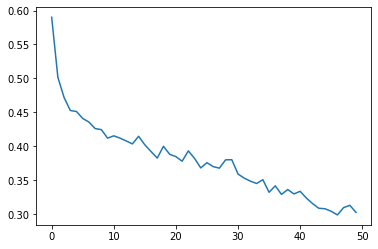

In [ ]:
plt.plot(history.epoch, history.history['loss'], label = 'total loss')
plt.show()

Create Memo

In [ ]:
def predict_next_note(notes: np.ndarray, keras_model: tf.keras.Model, Temperature: float = 1.0) -> int:
  '''
  Generates a note IDs using a trained sequence model.
  '''

  assert temperature > 0

  # Add batch dimension
  inputs = tf.expand_dims(notes, 0)

  predictions = model.predict(inputs)
  pitch_logits = predictions['pitch']
  step = predictions['step']
  duration = predictions['duration']

  pitch_logits /= temperature
  pitch = tf.random.categorical(pitch_logits, num_samples = 1)
  pitch = tf.squeeze(pitch, axis = -1)
  duration = tf.squeeze(duration, axis = -1)
  step = tf.squeeze(step, axis = -1)

  # 'step' and 'duration' values should be non-negative
  step = tf.maximum(0, step)
  duration = tf.maximum(0, duration)

  return int(pitch), float(step), float(duration)

In [ ]:
temperature = 2.0
num_predictions = 120

sample_notes = np.stack([raw_notes[key] for key in key_order], axis=1)

# The initial sequence of notes; pitch is normalized similar to training
# sequences
input_notes = (
    sample_notes[:seq_length] / np.array([vocab_size, 1, 1]))

generated_notes = []
prev_start = 0
for _ in range(num_predictions):
  pitch, step, duration = predict_next_note(input_notes, model, temperature)
  start = prev_start + step
  end = start + duration
  input_note = (pitch, step, duration)
  generated_notes.append((*input_note, start, end))
  input_notes = np.delete(input_notes, 0, axis=0)
  input_notes = np.append(input_notes, np.expand_dims(input_note, 0), axis=0)
  prev_start = start

generated_notes = pd.DataFrame(
    generated_notes, columns=(*key_order, 'start', 'end'))

1/1 [==============================] - 0s 21ms/step


In [ ]:
generated_notes.head(10)

,pitch,step,duration,start,end
0,63,0.483362,0.192516,0.483362,0.675878
1,58,0.000000,0.000000,0.483362,0.483362
2,93,0.000000,0.000000,0.483362,0.483362
3,62,0.000000,0.000000,0.483362,0.483362
4,58,0.000000,0.000000,0.483362,0.483362
5,62,0.000000,0.000000,0.483362,0.483362
6,93,0.000000,0.000000,0.483362,0.483362
7,95,0.000000,0.000000,0.483362,0.483362
8,58,0.000000,0.000000,0.483362,0.483362
9,62,0.000000,0.000000,0.483362,0.483362


In [ ]:
out_file = 'output.mid'
out_pm = notes_to_midi(generated_notes, out_file = out_file, instrument_name = instrument_name)
display_audio(out_pm)

In [ ]:
# download output audion file

#from google.colab import files
#files.download(out_file)

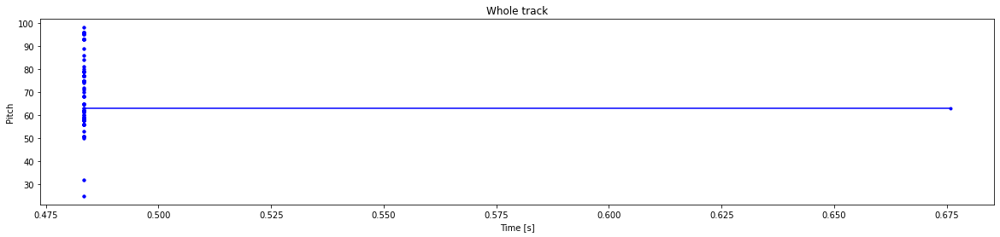

In [ ]:
plot_piano_roll(generated_notes)

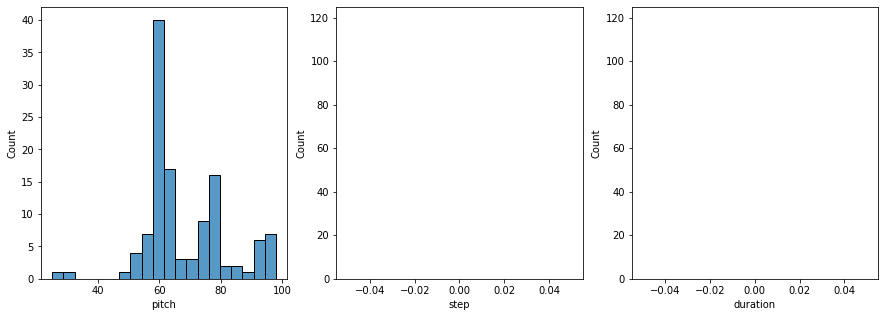

In [ ]:
plot_distributions(generated_notes)